In [111]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from Grafico import Grafico
%matplotlib inline

In [119]:
df = pd.read_excel('Muestras_planta.xlsx')
df.columns

Index(['Nombre MP', 'Peso tara', 'Peso bruto', 'Utensilio', 'Peso perdida',
       'Cantidad', 'Medicion', 'Perdida teorica', '% Error', '% Desv',
       '% Complem', '% Tot', 'Muestreo '],
      dtype='object')

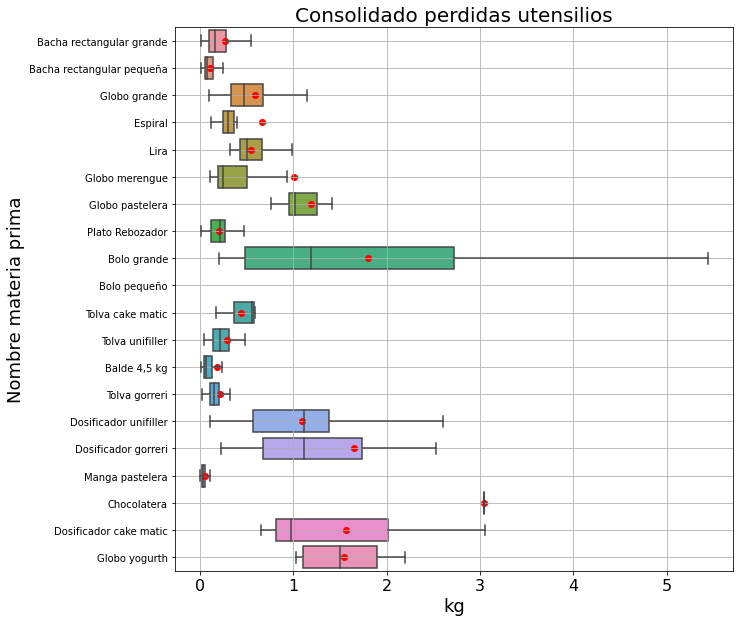

In [113]:
dt = df[df['Utensilio']!='Remojo gorreri']
ref = dt['Utensilio'].drop_duplicates()
fig, ax = plt.subplots(figsize=(10,10))
sns.boxplot(data=dt,x='Peso perdida',y='Utensilio',showfliers=False)
ax.set_title('Consolidado perdidas utensilios',size=20)
ax.set_xlabel('kg',size=18)
ax.set_ylabel('Nombre materia prima',size=18)
ax.tick_params(axis='x',labelsize=16)
for ut in ref:
    df4 = dt[dt['Utensilio']==ut]
    ax.scatter(np.mean(df4['Peso perdida']),ut,c='r')
ax.grid()

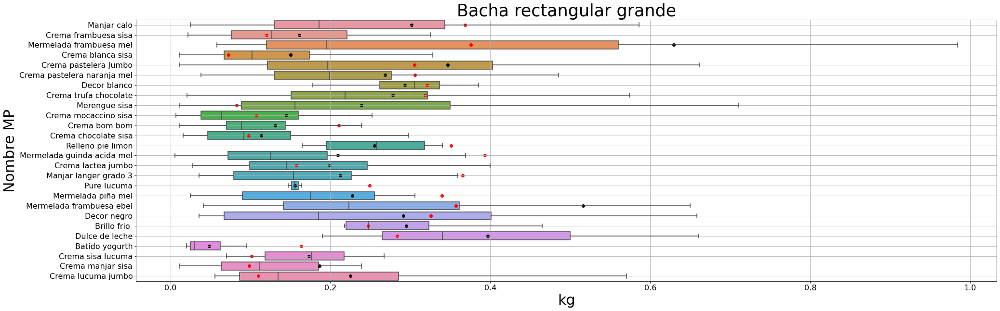

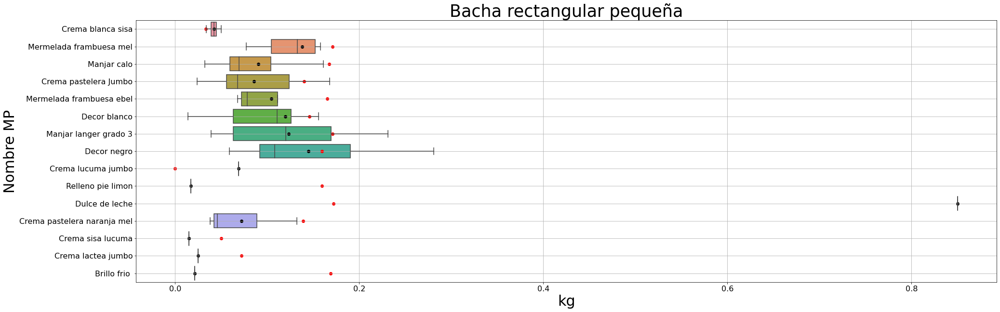

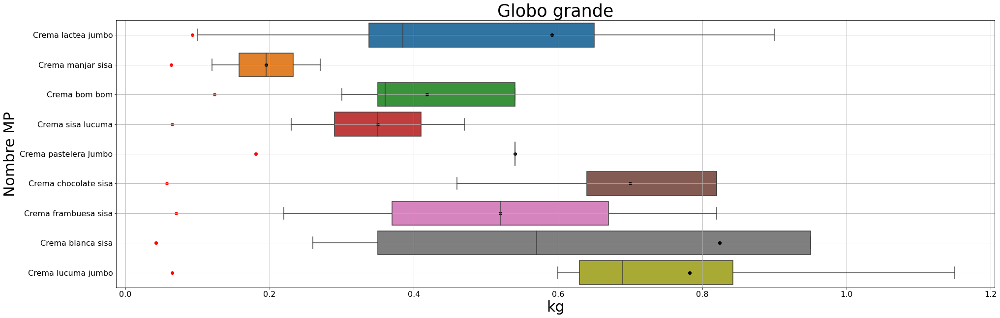

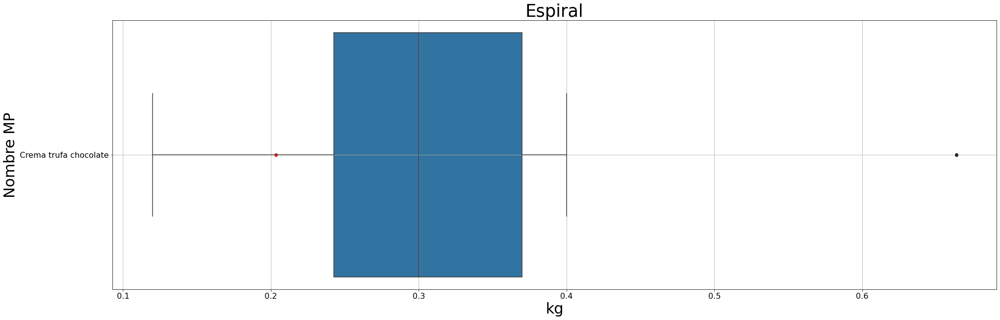

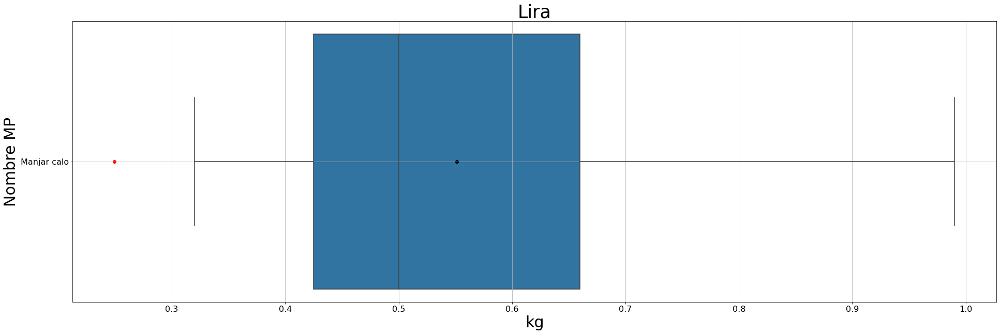

...

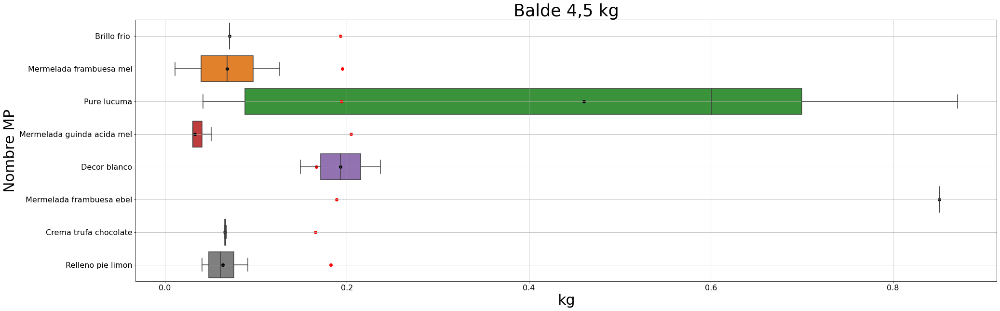

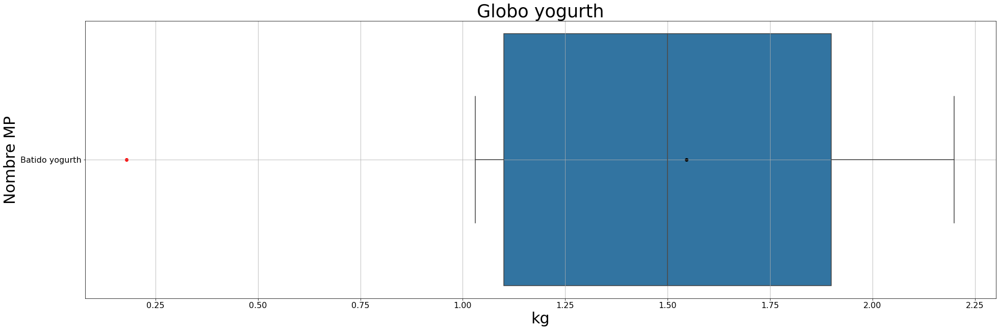

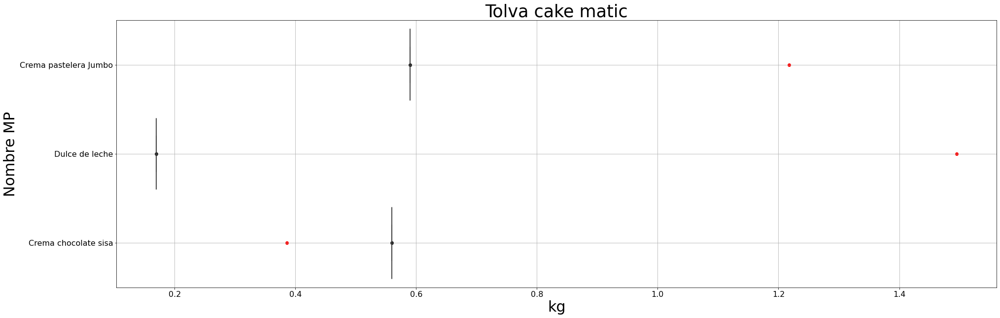

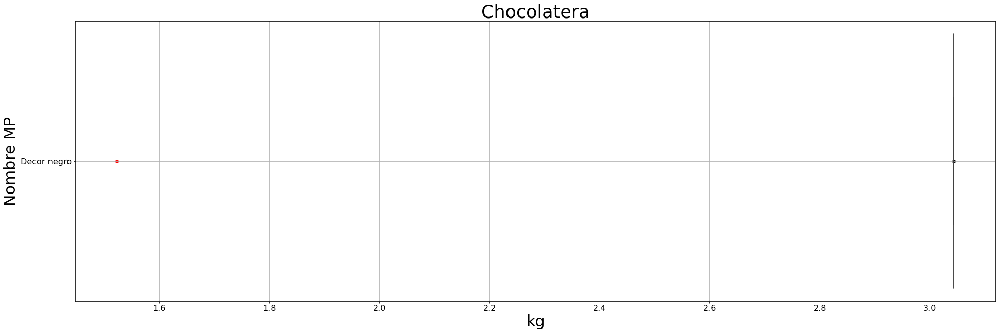

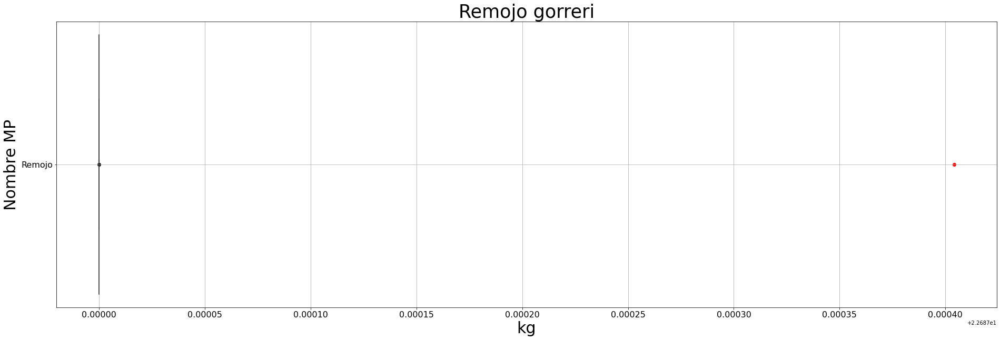

In [128]:
Utensilio = df['Utensilio'].drop_duplicates()
for Ute in Utensilio:
    df3 = df[df['Utensilio']==Ute]
    df5 = df3['Nombre MP'].drop_duplicates()
    fig, ax = plt.subplots(figsize=(32,10))
    sns.boxplot(data=df3,x='Peso perdida',y='Nombre MP',showfliers=False)
    ax.set_title(str(Ute),size=35)
    ax.set_xlabel('kg',size=30)
    ax.set_ylabel('Nombre MP',size=30)
    ax.tick_params(axis='x',labelsize=16)
    ax.tick_params(axis='y',labelsize=16)
    ax.grid()
    for mp in df5:
        gf = df3[df3['Nombre MP']==mp]
        ax.scatter(np.mean(gf['Peso perdida']),mp,c='k',label='Promedio muestral')
        ax.scatter(np.mean(gf['Perdida teorica']),mp,c='r',label='Promedio teorico')
    plt.savefig(str(Ute)+'.jpg',format='jpg')

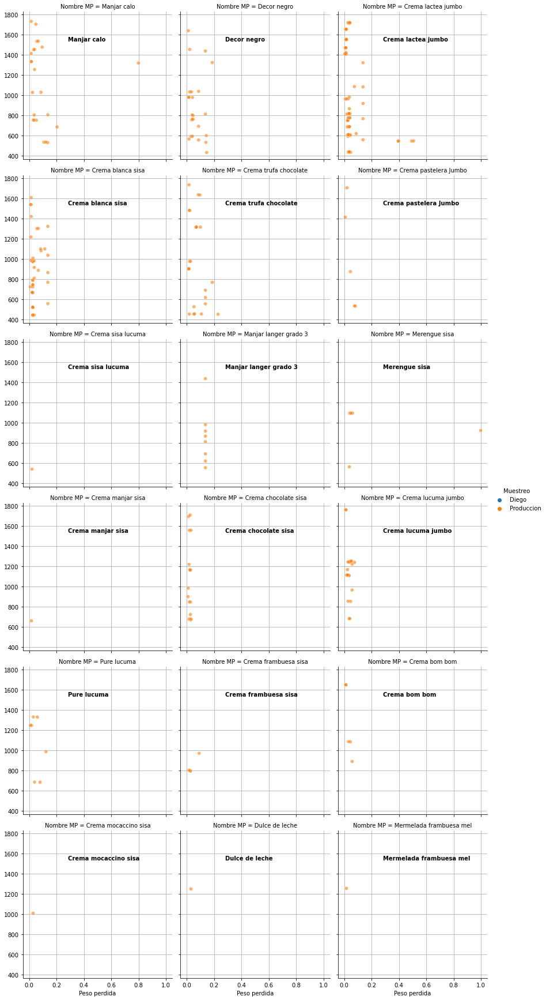

In [16]:
df2 = df[df['Utensilio']=='Manga pastelera']
j = sns.relplot(data=df2,x='Peso perdida',y=df2['Peso perdida'].index,col='Nombre MP',hue='Muestreo ',col_wrap=3,zorder=6,height=4,alpha=0.6)
for fig, ax in j.axes_dict.items():
    ax.text(.3,.8,fig,transform=ax.transAxes,fontweight='bold')
    ax.grid()
    #sns.boxplot(data=df2,x='Peso perdida',color='.9',linewidth=.5,ax=ax)
    #ax.axvline(x=np.mean(j),color='red',linestyle='--',label='Perdida teorica')
    #ax.axvline(x=np.mean(df2[(df['Nombre MP'] == fig)]),color='green',linestyle='--',label='Perdida real')
#plt.savefig('Manga_pastelera.jpg',format='jpg') #Guarda imagen en carpeta en format jpg

In [129]:
df.columns

Index(['Nombre MP', 'Peso tara', 'Peso bruto', 'Utensilio', 'Peso perdida',
       'Cantidad', 'Medicion', 'Perdida teorica', '% Error', '% Desv',
       '% Complem', '% Tot', 'Muestreo '],
      dtype='object')

In [44]:
#g = sns.relplot(data=df,x='Numero',y='Peso perdida',hue='Nombre MP',size='Utensilio')

In [97]:
#fig, ax = plt.subplots()
#sns.boxplot(x='Peso perdida',y='Utensilio',data=df)

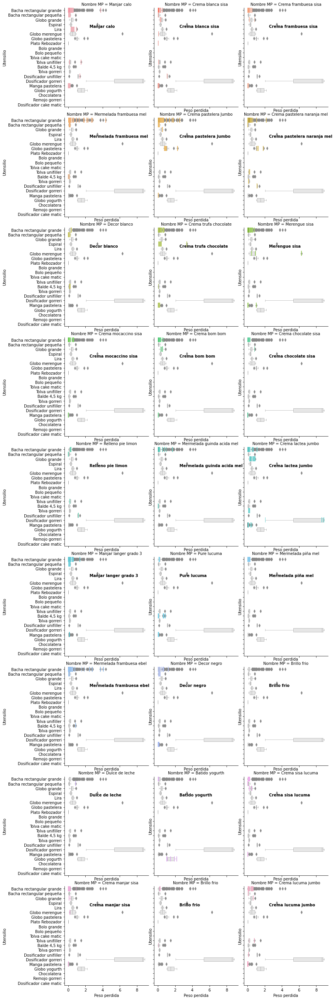

In [164]:
dat = df.copy()
g = sns.displot(data=dat,x='Peso perdida',y='Utensilio',col='Nombre MP',hue='Nombre MP',linewidth=4,zorder=6,col_wrap=3,height=4,aspect=1,legend=False)
for Utensilio, ax in g.axes_dict.items():
    ax.text(.3,.8,Utensilio,transform=ax.transAxes,fontweight='bold')
    sns.boxplot(data=dat,x='Peso perdida',y='Utensilio',color='.9',linewidth=.5,ax=ax)

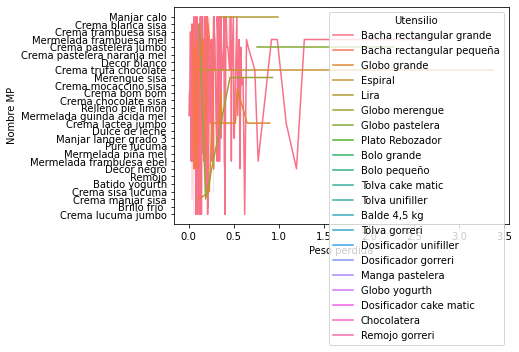

In [82]:
dd = sns.lineplot(data=df,x='Peso perdida',y='Nombre MP',hue='Utensilio')

In [22]:
utensilio = df.copy()
BRG = df[(df['Utensilio'] == 'Bacha rectangular grande')&(df['Nombre MP'] == 'Manjar calo')]

In [23]:
GGCL = df[(df['Utensilio'] == 'Globo grande')&(df['Nombre MP'] == 'Crema lactea jumbo')]
nmp = GGCL['Nombre MP']
pp = GGCL['Peso perdida']
pt = GGCL['Perdida teorica']

In [24]:
nombre_mp = BRG['Nombre MP']
peso_perdida = BRG['Peso perdida']
p_t = BRG['Perdida teorica']

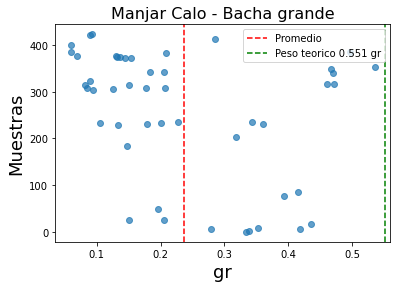

In [25]:
fig, ax = plt.subplots()
ax.scatter(peso_perdida,peso_perdida.index,alpha=0.7)
ax.axvline(x=np.mean(peso_perdida),color='red',linestyle='--',label='Promedio')
ax.axvline(x=np.mean(p_t),color='green',linestyle='--',label='Peso teorico '+str(round(np.mean(p_t),3))+' gr')
ax.set_title('Manjar Calo - Bacha grande',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

<AxesSubplot:ylabel='Peso perdida'>

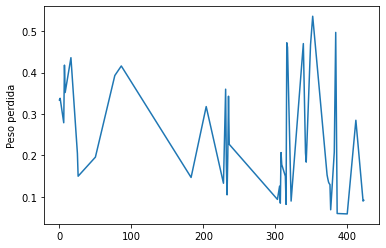

In [33]:
fig, ax = plt.subplots()
sns.lineplot(x=peso_perdida.index,y=peso_perdida)

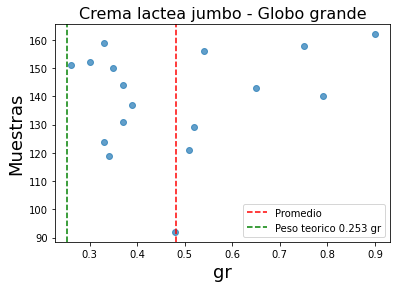

In [46]:
fig, ax = plt.subplots()
ax.scatter(pp,pp.index,alpha=0.7)
ax.axvline(x=np.mean(pp),color='red',linestyle='--',label='Promedio')
ax.axvline(x=np.mean(pt),color='green',linestyle='--',label='Peso teorico '+str(round(np.mean(pt),3))+' gr')
ax.set_title('Crema lactea jumbo - Globo grande',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

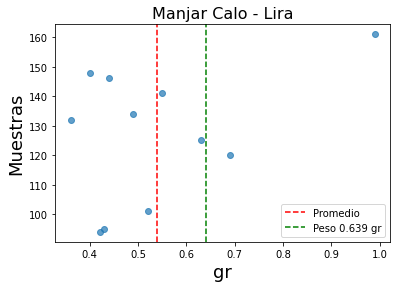

In [48]:
LMC = df[(df['Utensilio'] == 'Lira')&(df['Nombre MP'] == 'Manjar calo')]
lmc = LMC['Perdida teorica']
pp_lmc = LMC['Peso perdida']
fig, ax = plt.subplots()
ax.scatter(pp_lmc,pp_lmc.index,alpha=0.7)
ax.axvline(x=np.mean(pp_lmc),color='red',linestyle='--',label='Promedio')
ax.axvline(x=np.mean(lmc),color='green',linestyle='--',label='Peso '+str(round(np.mean(lmc),3))+' gr')
ax.set_title('Manjar Calo - Lira',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

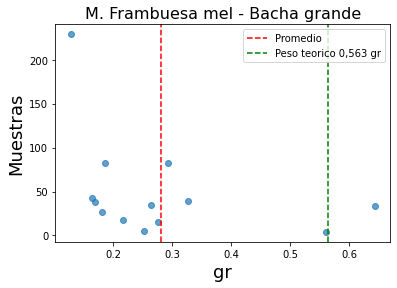

In [10]:
bgmf = df[(df['Utensilio'] == 'Bacha rectangular grande')&(df['Nombre MP'] == 'Mermelada frambuesa mel')]
bg_mf = bgmf['Nombre MP']
pp_mf = bgmf['Peso perdida']
fig, ax = plt.subplots()
ax.scatter(pp_mf,pp_mf.index,alpha=0.7)
ax.axvline(x=np.mean(pp_mf),color='red',linestyle='--',label='Promedio')
ax.axvline(x=0.563,color='green',linestyle='--',label='Peso teorico 0,563 gr')
ax.set_title('M. Frambuesa mel - Bacha grande',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

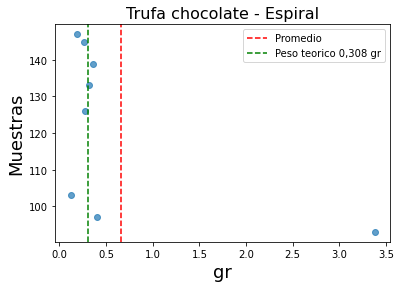

In [11]:
t_es = df[(df['Utensilio'] == 'Espiral')&(df['Nombre MP'] == 'Crema trufa chocolate')]
T_es = t_es['Nombre MP']
pp_tes = t_es['Peso perdida']
fig, ax = plt.subplots()
ax.scatter(pp_tes,pp_tes.index,alpha=0.7)
ax.axvline(x=np.mean(pp_tes),color='red',linestyle='--',label='Promedio')
ax.axvline(x=0.308,color='green',linestyle='--',label='Peso teorico 0,308 gr')
ax.set_title('Trufa chocolate - Espiral',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

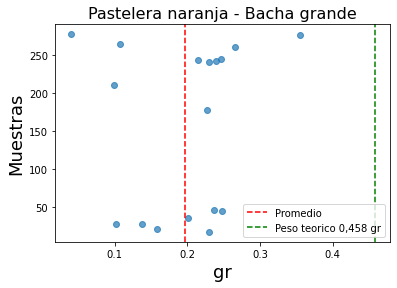

In [12]:
t_bcpn = df[(df['Utensilio'] == 'Bacha rectangular grande')&(df['Nombre MP'] == 'Crema pastelera naranja mel')]
T_es = t_bcpn['Nombre MP']
pp_bcpn = t_bcpn['Peso perdida']
fig, ax = plt.subplots()
ax.scatter(pp_bcpn,pp_bcpn.index,alpha=0.7)
ax.axvline(x=np.mean(pp_bcpn),color='red',linestyle='--',label='Promedio')
ax.axvline(x=0.458,color='green',linestyle='--',label='Peso teorico 0,458 gr')
ax.set_title('Pastelera naranja - Bacha grande',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

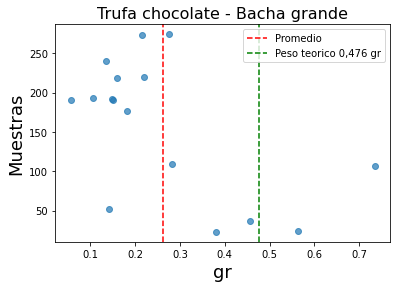

In [13]:
t_bct = df[(df['Utensilio'] == 'Bacha rectangular grande')&(df['Nombre MP'] == 'Crema trufa chocolate')]
pp_bct = t_bct['Peso perdida']
fig, ax = plt.subplots()
ax.scatter(pp_bct,pp_bct.index,alpha=0.7)
ax.axvline(x=np.mean(pp_bct),color='red',linestyle='--',label='Promedio')
ax.axvline(x=0.476,color='green',linestyle='--',label='Peso teorico 0,476 gr')
ax.set_title('Trufa chocolate - Bacha grande',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

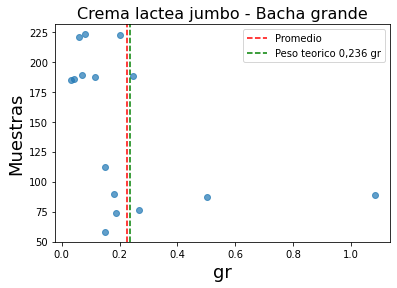

In [14]:
t_bcl = df[(df['Utensilio'] == 'Bacha rectangular grande')&(df['Nombre MP'] == 'Crema lactea jumbo')]
pp_bcl = t_bcl['Peso perdida']
fig, ax = plt.subplots()
ax.scatter(pp_bcl,pp_bcl.index,alpha=0.7)
ax.axvline(x=np.mean(pp_bcl),color='red',linestyle='--',label='Promedio')
ax.axvline(x=0.236,color='green',linestyle='--',label='Peso teorico 0,236 gr')
ax.set_title('Crema lactea jumbo - Bacha grande',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

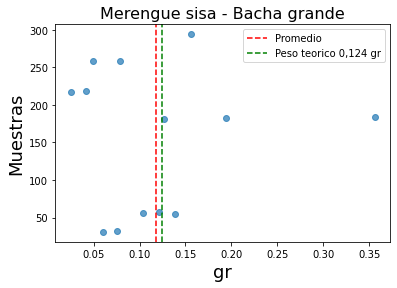

In [15]:
t_bms = df[(df['Utensilio'] == 'Bacha rectangular grande')&(df['Nombre MP'] == 'Merengue sisa')]
pp_bms = t_bms['Peso perdida']
fig, ax = plt.subplots()
ax.scatter(pp_bms,pp_bms.index,alpha=0.7)
ax.axvline(x=np.mean(pp_bms),color='red',linestyle='--',label='Promedio')
ax.axvline(x=0.124,color='green',linestyle='--',label='Peso teorico 0,124 gr')
ax.set_title('Merengue sisa - Bacha grande',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

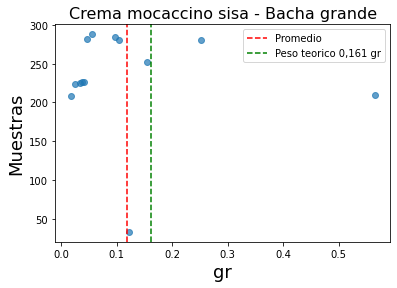

In [16]:
t_bcms = df[(df['Utensilio'] == 'Bacha rectangular grande')&(df['Nombre MP'] == 'Crema mocaccino sisa')]
pp_bcms = t_bcms['Peso perdida']
fig, ax = plt.subplots()
ax.scatter(pp_bcms,pp_bcms.index,alpha=0.7)
ax.axvline(x=np.mean(pp_bcms),color='red',linestyle='--',label='Promedio')
ax.axvline(x=0.161,color='green',linestyle='--',label='Peso teorico 0,161 gr')
ax.set_title('Crema mocaccino sisa - Bacha grande',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

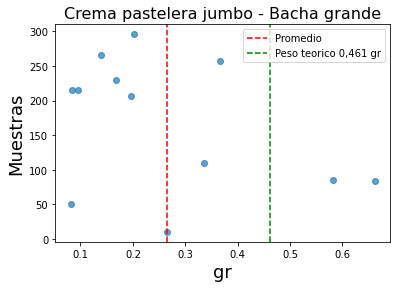

In [25]:
t_bcpj = df[(df['Utensilio'] == 'Bacha rectangular grande')&(df['Nombre MP'] == 'Crema pastelera Jumbo')]
pp_bcpj = t_bcpj['Peso perdida']
fig, ax = plt.subplots()
ax.scatter(pp_bcpj,pp_bcpj.index,alpha=0.7)
ax.axvline(x=np.mean(pp_bcpj),color='red',linestyle='--',label='Promedio')
ax.axvline(x=0.461,color='green',linestyle='--',label='Peso teorico 0,461 gr')
ax.set_title('Crema pastelera jumbo - Bacha grande',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()

/Users/diegosaldias/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


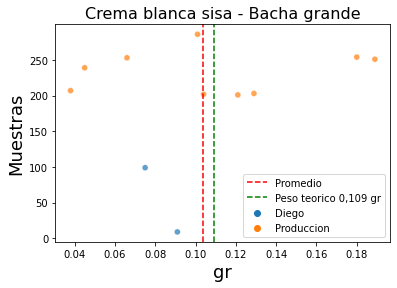

In [56]:
t_bcbs = df[(df['Utensilio'] == 'Bacha rectangular grande')&(df['Nombre MP'] == 'Crema blanca sisa')]
pp_bcbs = t_bcbs['Peso perdida']
fig, ax = plt.subplots()
sns.scatterplot(pp_bcbs,pp_bcbs.index,alpha=0.7,hue=t_bcbs['Muestreo '])
ax.axvline(x=np.mean(pp_bcbs),color='red',linestyle='--',label='Promedio')
ax.axvline(x=0.109,color='green',linestyle='--',label='Peso teorico 0,109 gr')
ax.set_title('Crema blanca sisa - Bacha grande',size=16)
ax.set_xlabel('gr',size=18)
ax.set_ylabel('Muestras',size=18)
ax.legend()